In [1]:
# P. Barry Seavey
# MSDS 498-57, Summer 2018
# Home Credit Group Project
# https://www.kaggle.com/c/home-credit-default-risk/data

In [2]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
%matplotlib inline
import seaborn as sns

In [3]:
import os
print(os.listdir('../Credit Risk'))

['.ipynb_checkpoints', '.Rhistory', 'AGE_YRS.png', 'AMT_ANNUITY_kde.png', 'AMT_ANN_1.png', 'AMT_ANN_2.png', 'AMT_CREDIT_kde.png', 'application_test.csv', 'application_test20.csv', 'application_test20_merge_trans.csv', 'application_test20_trans.csv', 'application_train.csv', 'application_train80.csv', 'application_train80_merge_trans.csv', 'application_train80_merge_trans.zip', 'application_train80_trans.csv', 'app_train_80_mod.csv', 'Barry_Proposed Variable Changes_code.html', 'best_model.h5', 'best_model2.h5', 'best_model3.h5', 'bureau.csv', 'bureau_balance.csv', 'CM_LGBM.png', 'correlations.xlsx', 'credit_card_balance.csv', 'CR_Data_Experiments.ipynb', 'CR_new_features-2-test.ipynb', 'CR_new_features-2-train.ipynb', 'CR_new_features.ipynb', 'CR_Proposed Variable Changes.ipynb', 'Data Files.zip', 'data_transform_proposed.pdf', 'data_trans_proposed.docx', 'EXT1_comparison.png', 'EXT2_comparison.png', 'EXT3_comparison.png', 'EXT_123.png', 'EXT_1_kde.png', 'EXT_2 imputation.csv', 'EXT_2.

In [4]:
import lightgbm as lgb

In [5]:
traindata = pd.read_csv('application_train80_merge_trans.csv')

In [6]:
traindata.head(3)

,SK_ID_CURR,TARGET,AMT_ANNUITY,AMT_CREDIT,AMT_GOODS_PRICE,AMT_INCOME_TOTAL,AMT_REQ_CREDIT_BUREAU_YEAR,CNT_CHILDREN,CNT_FAM_MEMBERS,CODE_GENDER,...,PREVIOUS_NAME_YIELD_GROUP_LOW_NORMAL,PREVIOUS_NAME_YIELD_GROUP_MIDDLE,PREVIOUS_NAME_YIELD_GROUP_NA,PREVIOUS_PRODUCT_COMBINATION_CARD_STREET,PREVIOUS_PRODUCT_COMBINATION_CARD_X_SELL,PREVIOUS_PRODUCT_COMBINATION_CASH,PREVIOUS_PRODUCT_COMBINATION_CASH_STREET,PREVIOUS_PRODUCT_COMBINATION_CASH_X_SELL,PREVIOUS_PRODUCT_COMBINATION_POS,PREVIOUS_PRODUCT_COMBINATION_NA
0,100002,1,3,3,4,5,1,0,1,0,...,0,0,0,0,0,0,0,0,1,0
1,100003,0,4,7,10,6,0,0,2,1,...,0,0,0,0,0,0,0,1,2,0
2,100004,0,1,1,2,2,0,0,1,0,...,0,0,0,0,0,0,0,0,1,0


In [7]:
new_train = pd.read_csv('newdatatoadd.csv')

In [8]:
new_train.head(3)

,Unnamed: 0,SK_ID_CURR,RATIO_ANN_INC,RATIO_ANN_CREDIT,RATIO_CREDIT_INC
0,0,100002,0.121978,0.060749,2.007889
1,1,100003,0.132217,0.027598,4.790750
2,2,100004,0.100000,0.050000,2.000000


In [9]:
new_train.drop(new_train.columns[0], axis=1, inplace=True)

In [10]:
new_train.head(3)

,SK_ID_CURR,RATIO_ANN_INC,RATIO_ANN_CREDIT,RATIO_CREDIT_INC
0,100002,0.121978,0.060749,2.007889
1,100003,0.132217,0.027598,4.790750
2,100004,0.100000,0.050000,2.000000


In [11]:
traindata = traindata.join(new_train.set_index('SK_ID_CURR'), on='SK_ID_CURR')

In [12]:
traindata.head(3)

,SK_ID_CURR,TARGET,AMT_ANNUITY,AMT_CREDIT,AMT_GOODS_PRICE,AMT_INCOME_TOTAL,AMT_REQ_CREDIT_BUREAU_YEAR,CNT_CHILDREN,CNT_FAM_MEMBERS,CODE_GENDER,...,PREVIOUS_PRODUCT_COMBINATION_CARD_STREET,PREVIOUS_PRODUCT_COMBINATION_CARD_X_SELL,PREVIOUS_PRODUCT_COMBINATION_CASH,PREVIOUS_PRODUCT_COMBINATION_CASH_STREET,PREVIOUS_PRODUCT_COMBINATION_CASH_X_SELL,PREVIOUS_PRODUCT_COMBINATION_POS,PREVIOUS_PRODUCT_COMBINATION_NA,RATIO_ANN_INC,RATIO_ANN_CREDIT,RATIO_CREDIT_INC
0,100002,1,3,3,4,5,1,0,1,0,...,0,0,0,0,0,1,0,0.121978,0.060749,2.007889
1,100003,0,4,7,10,6,0,0,2,1,...,0,0,0,0,1,2,0,0.132217,0.027598,4.790750
2,100004,0,1,1,2,2,0,0,1,0,...,0,0,0,0,0,1,0,0.100000,0.050000,2.000000


In [13]:
traindata['EXT1_EXT2'] = traindata.EXT_SOURCE_1 * traindata.EXT_SOURCE_2_IMP
traindata['EXT2_EXT3'] = traindata.EXT_SOURCE_2_IMP * traindata.EXT_SOURCE_3
traindata['EXT1_EXT3'] = traindata.EXT_SOURCE_1 * traindata.EXT_SOURCE_3
traindata['EXT1_EXT_2_EXT3'] = traindata.EXT_SOURCE_1 * traindata.EXT_SOURCE_2_IMP * traindata.EXT_SOURCE_3

In [81]:
set_palette='colorblind'

C:\Users\Barry\Anaconda3\lib\site-packages\scipy\stats\stats.py:1713: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will result either in an error or a different result.
  return np.add.reduce(sorted[indexer] * weights, axis=axis) / sumval


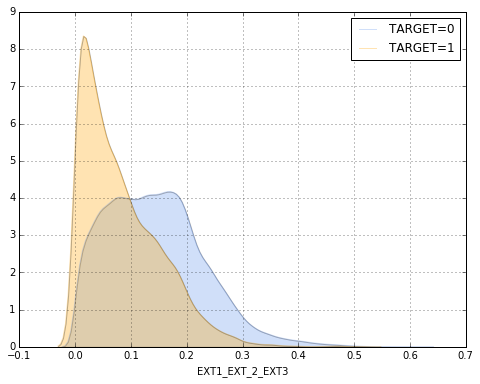

In [87]:
fig = plt.figure(figsize=(8,6))
sns.kdeplot(traindata.loc[traindata['TARGET']==0, 'EXT1_EXT_2_EXT3'], label='TARGET=0', shade=True, alpha=0.3,color='cornflowerblue')
sns.kdeplot(traindata.loc[traindata['TARGET']==1, 'EXT1_EXT_2_EXT3'], label='TARGET=1', shade=True, alpha=0.3, color='orange')
plt.grid(True)
plt.xlabel('EXT1_EXT_2_EXT3')
plt.savefig('EXT_123.png', bbox_inches='tight');

C:\Users\Barry\Anaconda3\lib\site-packages\scipy\stats\stats.py:1713: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will result either in an error or a different result.
  return np.add.reduce(sorted[indexer] * weights, axis=axis) / sumval


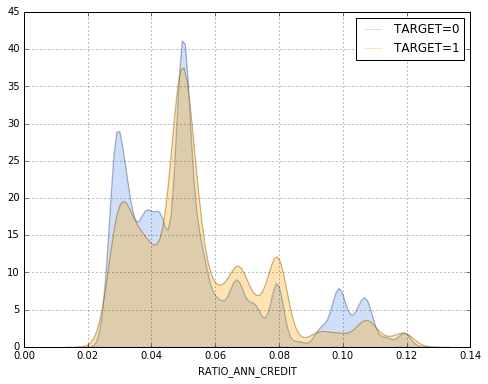

In [91]:
fig = plt.figure(figsize=(8,6))
sns.kdeplot(traindata.loc[traindata['TARGET']==0, 'RATIO_ANN_CREDIT'], label='TARGET=0', shade=True, alpha=0.3,color='cornflowerblue')
sns.kdeplot(traindata.loc[traindata['TARGET']==1, 'RATIO_ANN_CREDIT'], label='TARGET=1', shade=True, alpha=0.3, color='orange')
plt.xlabel('RATIO_ANN_CREDIT')
plt.grid(True)
plt.savefig('RATIO_ANN_CRED.png', bbox_inches='tight');

In [14]:
testdata = pd.read_csv('application_test20_merge_trans.csv')

In [15]:
testdata.head()

,SK_ID_CURR,TARGET,AMT_ANNUITY,AMT_CREDIT,AMT_GOODS_PRICE,AMT_INCOME_TOTAL,AMT_REQ_CREDIT_BUREAU_YEAR,CNT_CHILDREN,CNT_FAM_MEMBERS,CODE_GENDER,...,PREVIOUS_NAME_YIELD_GROUP_LOW_NORMAL,PREVIOUS_NAME_YIELD_GROUP_MIDDLE,PREVIOUS_NAME_YIELD_GROUP_NA,PREVIOUS_PRODUCT_COMBINATION_CARD_STREET,PREVIOUS_PRODUCT_COMBINATION_CARD_X_SELL,PREVIOUS_PRODUCT_COMBINATION_CASH,PREVIOUS_PRODUCT_COMBINATION_CASH_STREET,PREVIOUS_PRODUCT_COMBINATION_CASH_X_SELL,PREVIOUS_PRODUCT_COMBINATION_POS,PREVIOUS_PRODUCT_COMBINATION_NA
0,100007,0,3,4,6,3,0,0,1,0,...,0,0,0,0,0,0,1,3,2,0
1,100018,0,4,5,7,4,11,0,2,1,...,0,0,0,0,0,0,0,0,4,0
2,100021,0,2,3,3,2,11,1,3,1,...,0,0,1,0,1,1,0,0,5,0
3,100022,0,1,2,2,3,0,0,1,1,...,0,0,0,0,0,0,0,0,1,0
4,100023,0,2,4,5,2,2,1,2,1,...,0,0,1,1,0,0,0,1,1,0


In [16]:
new_test = pd.read_csv('newdatatest.csv')

In [17]:
new_test.head()

,SK_ID_CURR,RATIO_ANN_INC,RATIO_ANN_CREDIT,RATIO_CREDIT_INC
0,100007,0.179963,0.042623,4.222222
1,100018,0.173429,0.042366,4.093548
2,100021,0.166667,0.050000,3.333333
3,100022,0.070000,0.050000,1.400000
4,100023,0.195150,0.032257,6.049900


In [18]:
testdata = testdata.join(new_test.set_index('SK_ID_CURR'), on='SK_ID_CURR')

In [19]:
testdata['EXT1_EXT2'] = testdata.EXT_SOURCE_1 * testdata.EXT_SOURCE_2_IMP
testdata['EXT2_EXT3'] = testdata.EXT_SOURCE_2_IMP * testdata.EXT_SOURCE_3
testdata['EXT1_EXT3'] = testdata.EXT_SOURCE_1 * testdata.EXT_SOURCE_3
testdata['EXT1_EXT_2_EXT3'] = testdata.EXT_SOURCE_1 * testdata.EXT_SOURCE_2_IMP * testdata.EXT_SOURCE_3

In [20]:
testdata.head(3)

,SK_ID_CURR,TARGET,AMT_ANNUITY,AMT_CREDIT,AMT_GOODS_PRICE,AMT_INCOME_TOTAL,AMT_REQ_CREDIT_BUREAU_YEAR,CNT_CHILDREN,CNT_FAM_MEMBERS,CODE_GENDER,...,PREVIOUS_PRODUCT_COMBINATION_CASH_X_SELL,PREVIOUS_PRODUCT_COMBINATION_POS,PREVIOUS_PRODUCT_COMBINATION_NA,RATIO_ANN_INC,RATIO_ANN_CREDIT,RATIO_CREDIT_INC,EXT1_EXT2,EXT2_EXT3,EXT1_EXT3,EXT1_EXT_2_EXT3
0,100007,0,3,4,6,3,0,0,1,0,...,3,2,0,0.179963,0.042623,4.222222,0.163695,0.172754,0.271495,0.087622
1,100018,0,4,5,7,4,11,0,2,1,...,0,4,0,0.173429,0.042366,4.093548,0.463959,0.343999,0.386437,0.248346
2,100021,0,2,3,3,2,11,1,3,1,...,0,5,0,0.166667,0.050000,3.333333,0.346682,0.365868,0.271495,0.185570


In [21]:
#

In [22]:
y_train = traindata['TARGET']
y_test = testdata['TARGET']

In [23]:
X_train = traindata.drop(['SK_ID_CURR', 'TARGET'], axis=1)
X_test = testdata.drop(['SK_ID_CURR', 'TARGET'], axis=1)

In [24]:
from lightgbm import LGBMClassifier

In [25]:
gbm = LGBMClassifier(objective='binary', num_leaves=31)

In [26]:
from sklearn.model_selection import GridSearchCV

In [27]:
params = {'learning_rate': [0.05, 0.1],
         'feature_fraction': [0.8, 0.9],
          'colsample_bytree': [0.6, 0.7],
         'bagging_freq': [2, 3, 4],
          'num_leaves': [2, 3, 4]
         }

In [28]:
gbm_CV = GridSearchCV(gbm, param_grid=params)

In [29]:
gbm_CV.fit(X_train, y_train)

C:\Users\Barry\Anaconda3\lib\site-packages\sklearn\preprocessing\label.py:151: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  if diff:
C:\Users\Barry\Anaconda3\lib\site-packages\sklearn\preprocessing\label.py:151: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  if diff:
C:\Users\Barry\Anaconda3\lib\site-packages\sklearn\preprocessing\label.py:151: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  if diff:
C:\Users\Barry\Anaconda3\lib\site-packages\sklearn\preprocessing\label.py:151: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but i

C:\Users\Barry\Anaconda3\lib\site-packages\sklearn\preprocessing\label.py:151: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  if diff:
C:\Users\Barry\Anaconda3\lib\site-packages\sklearn\preprocessing\label.py:151: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  if diff:
C:\Users\Barry\Anaconda3\lib\site-packages\sklearn\preprocessing\label.py:151: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  if diff:
C:\Users\Barry\Anaconda3\lib\site-packages\sklearn\preprocessing\label.py:151: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but i

C:\Users\Barry\Anaconda3\lib\site-packages\sklearn\preprocessing\label.py:151: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  if diff:
C:\Users\Barry\Anaconda3\lib\site-packages\sklearn\preprocessing\label.py:151: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  if diff:
C:\Users\Barry\Anaconda3\lib\site-packages\sklearn\preprocessing\label.py:151: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  if diff:
C:\Users\Barry\Anaconda3\lib\site-packages\sklearn\preprocessing\label.py:151: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but i

C:\Users\Barry\Anaconda3\lib\site-packages\sklearn\preprocessing\label.py:151: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  if diff:
C:\Users\Barry\Anaconda3\lib\site-packages\sklearn\preprocessing\label.py:151: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  if diff:
C:\Users\Barry\Anaconda3\lib\site-packages\sklearn\preprocessing\label.py:151: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  if diff:
C:\Users\Barry\Anaconda3\lib\site-packages\sklearn\preprocessing\label.py:151: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but i

C:\Users\Barry\Anaconda3\lib\site-packages\sklearn\preprocessing\label.py:151: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  if diff:
C:\Users\Barry\Anaconda3\lib\site-packages\sklearn\preprocessing\label.py:151: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  if diff:
C:\Users\Barry\Anaconda3\lib\site-packages\sklearn\preprocessing\label.py:151: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  if diff:
C:\Users\Barry\Anaconda3\lib\site-packages\sklearn\preprocessing\label.py:151: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but i

C:\Users\Barry\Anaconda3\lib\site-packages\sklearn\preprocessing\label.py:151: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  if diff:
C:\Users\Barry\Anaconda3\lib\site-packages\sklearn\preprocessing\label.py:151: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  if diff:
C:\Users\Barry\Anaconda3\lib\site-packages\sklearn\preprocessing\label.py:151: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  if diff:
C:\Users\Barry\Anaconda3\lib\site-packages\sklearn\preprocessing\label.py:151: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but i

C:\Users\Barry\Anaconda3\lib\site-packages\sklearn\preprocessing\label.py:151: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  if diff:
C:\Users\Barry\Anaconda3\lib\site-packages\sklearn\preprocessing\label.py:151: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  if diff:
C:\Users\Barry\Anaconda3\lib\site-packages\sklearn\preprocessing\label.py:151: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  if diff:
C:\Users\Barry\Anaconda3\lib\site-packages\sklearn\preprocessing\label.py:151: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but i

C:\Users\Barry\Anaconda3\lib\site-packages\sklearn\preprocessing\label.py:151: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  if diff:
C:\Users\Barry\Anaconda3\lib\site-packages\sklearn\preprocessing\label.py:151: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  if diff:
C:\Users\Barry\Anaconda3\lib\site-packages\sklearn\preprocessing\label.py:151: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  if diff:
C:\Users\Barry\Anaconda3\lib\site-packages\sklearn\preprocessing\label.py:151: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but i

C:\Users\Barry\Anaconda3\lib\site-packages\sklearn\preprocessing\label.py:151: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  if diff:
C:\Users\Barry\Anaconda3\lib\site-packages\sklearn\preprocessing\label.py:151: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  if diff:
C:\Users\Barry\Anaconda3\lib\site-packages\sklearn\preprocessing\label.py:151: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  if diff:
C:\Users\Barry\Anaconda3\lib\site-packages\sklearn\preprocessing\label.py:151: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but i

C:\Users\Barry\Anaconda3\lib\site-packages\sklearn\preprocessing\label.py:151: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  if diff:
C:\Users\Barry\Anaconda3\lib\site-packages\sklearn\preprocessing\label.py:151: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  if diff:
C:\Users\Barry\Anaconda3\lib\site-packages\sklearn\preprocessing\label.py:151: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  if diff:
C:\Users\Barry\Anaconda3\lib\site-packages\sklearn\preprocessing\label.py:151: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but i

C:\Users\Barry\Anaconda3\lib\site-packages\sklearn\preprocessing\label.py:151: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  if diff:
C:\Users\Barry\Anaconda3\lib\site-packages\sklearn\preprocessing\label.py:151: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  if diff:
C:\Users\Barry\Anaconda3\lib\site-packages\sklearn\preprocessing\label.py:151: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  if diff:
C:\Users\Barry\Anaconda3\lib\site-packages\sklearn\preprocessing\label.py:151: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but i

C:\Users\Barry\Anaconda3\lib\site-packages\sklearn\preprocessing\label.py:151: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  if diff:
C:\Users\Barry\Anaconda3\lib\site-packages\sklearn\preprocessing\label.py:151: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  if diff:
C:\Users\Barry\Anaconda3\lib\site-packages\sklearn\preprocessing\label.py:151: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  if diff:
C:\Users\Barry\Anaconda3\lib\site-packages\sklearn\preprocessing\label.py:151: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but i

C:\Users\Barry\Anaconda3\lib\site-packages\sklearn\preprocessing\label.py:151: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  if diff:
C:\Users\Barry\Anaconda3\lib\site-packages\sklearn\preprocessing\label.py:151: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  if diff:
C:\Users\Barry\Anaconda3\lib\site-packages\sklearn\preprocessing\label.py:151: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  if diff:
C:\Users\Barry\Anaconda3\lib\site-packages\sklearn\preprocessing\label.py:151: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but i

C:\Users\Barry\Anaconda3\lib\site-packages\sklearn\preprocessing\label.py:151: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  if diff:
C:\Users\Barry\Anaconda3\lib\site-packages\sklearn\preprocessing\label.py:151: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  if diff:
C:\Users\Barry\Anaconda3\lib\site-packages\sklearn\preprocessing\label.py:151: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  if diff:
C:\Users\Barry\Anaconda3\lib\site-packages\sklearn\preprocessing\label.py:151: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but i

C:\Users\Barry\Anaconda3\lib\site-packages\sklearn\preprocessing\label.py:151: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  if diff:
C:\Users\Barry\Anaconda3\lib\site-packages\sklearn\preprocessing\label.py:151: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  if diff:
C:\Users\Barry\Anaconda3\lib\site-packages\sklearn\preprocessing\label.py:151: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  if diff:
C:\Users\Barry\Anaconda3\lib\site-packages\sklearn\preprocessing\label.py:151: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but i

GridSearchCV(cv=None, error_score='raise',
       estimator=LGBMClassifier(boosting_type='gbdt', class_weight=None, colsample_bytree=1.0,
        learning_rate=0.1, max_depth=-1, min_child_samples=20,
        min_child_weight=0.001, min_split_gain=0.0, n_estimators=100,
        n_jobs=-1, num_leaves=31, objective='binary', random_state=None,
        reg_alpha=0.0, reg_lambda=0.0, silent=True, subsample=1.0,
        subsample_for_bin=200000, subsample_freq=0),
       fit_params=None, iid=True, n_jobs=1,
       param_grid={'learning_rate': [0.05, 0.1], 'feature_fraction': [0.8, 0.9], 'colsample_bytree': [0.6, 0.7], 'bagging_freq': [2, 3, 4], 'num_leaves': [2, 3, 4]},
       pre_dispatch='2*n_jobs', refit=True, return_train_score='warn',
       scoring=None, verbose=0)

In [30]:
gbm_CV.best_params_

{'bagging_freq': 2,
 'colsample_bytree': 0.6,
 'feature_fraction': 0.9,
 'learning_rate': 0.1,
 'num_leaves': 4}

In [61]:
clf = lgb.LGBMClassifier(num_leaves= 4, max_depth=-1, 
                         random_state=123, 
                         n_estimators=1000, # use high number, let early-stop be decider when to quit
                         colsample_bytree=0.6,
                         bagging_freq=2,
                         feature_fraction=0.9,
                         subsample=0.9,
                         learning_rate=0.1,
                         is_unbalance=True)

In [62]:
fit_params={'early_stopping_rounds':10, 
            'eval_metric' : 'auc', 
            'eval_set' : [(X_test,y_test)],
            'eval_names': ['valid'],
            'verbose': 1,
           }

In [37]:
(clf.fit(X_train, y_train, **fit_params))

[1]	valid's auc: 0.699365
Training until validation scores don't improve for 10 rounds.
[2]	valid's auc: 0.711429
[3]	valid's auc: 0.715756
[4]	valid's auc: 0.719937
[5]	valid's auc: 0.72355
[6]	valid's auc: 0.724876
[7]	valid's auc: 0.726148
[8]	valid's auc: 0.726405
[9]	valid's auc: 0.727275
[10]	valid's auc: 0.727625
[11]	valid's auc: 0.728355
[12]	valid's auc: 0.72858
[13]	valid's auc: 0.729107
[14]	valid's auc: 0.729911
[15]	valid's auc: 0.730178
[16]	valid's auc: 0.730603
[17]	valid's auc: 0.731211
[18]	valid's auc: 0.733641
[19]	valid's auc: 0.73419
[20]	valid's auc: 0.734634
[21]	valid's auc: 0.735327
[22]	valid's auc: 0.735649
[23]	valid's auc: 0.736379
[24]	valid's auc: 0.737424
[25]	valid's auc: 0.738334
[26]	valid's auc: 0.738847
[27]	valid's auc: 0.739345
[28]	valid's auc: 0.739995
[29]	valid's auc: 0.74039
[30]	valid's auc: 0.741189
[31]	valid's auc: 0.7422
[32]	valid's auc: 0.74241
[33]	valid's auc: 0.742758
[34]	valid's auc: 0.743333
[35]	valid's auc: 0.743568
[36]	vali

LGBMClassifier(bagging_freq=2, boosting_type='gbdt', class_weight=None,
        colsample_bytree=0.6, feature_fraction=0.9, is_unbalance=True,
        learning_rate=0.1, max_depth=-1, min_child_samples=20,
        min_child_weight=0.001, min_split_gain=0.0, n_estimators=1000,
        n_jobs=-1, num_leaves=4, objective=None, random_state=123,
        reg_alpha=0.0, reg_lambda=0.0, silent=True, subsample=0.9,
        subsample_for_bin=200000, subsample_freq=0)

In [30]:
# Feature Importances

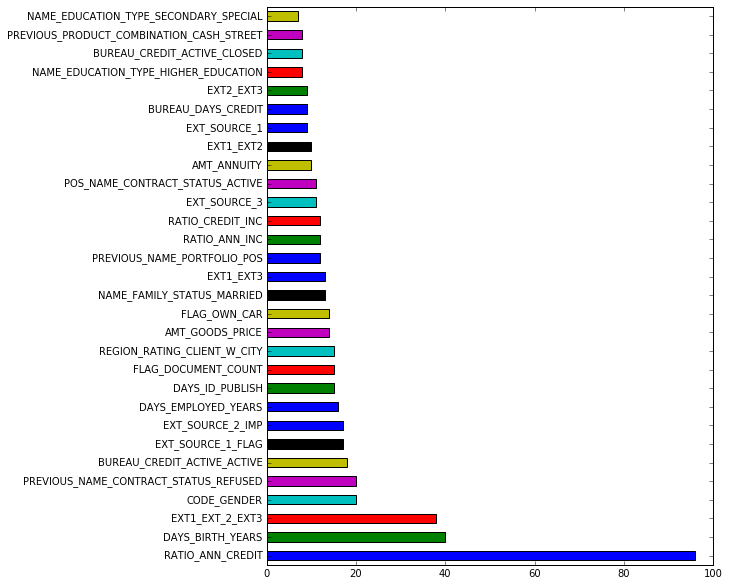

In [38]:
feat_imp = pd.Series(clf.feature_importances_, index=X_train.columns)
feat_imp.nlargest(30).plot(kind='barh', figsize=(8,10));

In [55]:
# Do some dropping of redundant variables

In [54]:
X_train.columns

Index(['AMT_GOODS_PRICE', 'AMT_REQ_CREDIT_BUREAU_YEAR', 'CNT_CHILDREN',
       'CNT_FAM_MEMBERS', 'CODE_GENDER', 'DAYS_BIRTH_YEARS',
       'DAYS_EMPLOYED_YEARS', 'DAYS_EMPLOYED_FLAG', 'DAYS_ID_PUBLISH',
       'DAYS_LAST_PHONE_CHANGE',
       ...
       'PREVIOUS_PRODUCT_COMBINATION_CARD_X_SELL',
       'PREVIOUS_PRODUCT_COMBINATION_CASH',
       'PREVIOUS_PRODUCT_COMBINATION_CASH_STREET',
       'PREVIOUS_PRODUCT_COMBINATION_CASH_X_SELL',
       'PREVIOUS_PRODUCT_COMBINATION_POS', 'PREVIOUS_PRODUCT_COMBINATION_NA',
       'RATIO_ANN_INC', 'RATIO_ANN_CREDIT', 'RATIO_CREDIT_INC',
       'EXT1_EXT_2_EXT3'],
      dtype='object', length=191)

In [39]:
X_train = X_train.drop(['EXT_SOURCE_1', 'EXT_SOURCE_2_IMP', 'EXT_SOURCE_3', 'EXT1_EXT3', 'EXT1_EXT2', 'EXT2_EXT3',
                       'AMT_ANNUITY', 'AMT_CREDIT', 'AMT_INCOME_TOTAL'], axis=1)

In [40]:
X_test = X_test.drop(['EXT_SOURCE_1', 'EXT_SOURCE_2_IMP', 'EXT_SOURCE_3', 'EXT1_EXT3', 'EXT1_EXT2', 'EXT2_EXT3',
                       'AMT_ANNUITY', 'AMT_CREDIT', 'AMT_INCOME_TOTAL'], axis=1)

In [44]:
X_train.shape

(246009, 191)

In [45]:
X_test.shape

(61502, 191)

In [49]:
y_train.shape

(246009,)

In [51]:
X_train.head()

,AMT_GOODS_PRICE,AMT_REQ_CREDIT_BUREAU_YEAR,CNT_CHILDREN,CNT_FAM_MEMBERS,CODE_GENDER,DAYS_BIRTH_YEARS,DAYS_EMPLOYED_YEARS,DAYS_EMPLOYED_FLAG,DAYS_ID_PUBLISH,DAYS_LAST_PHONE_CHANGE,...,PREVIOUS_PRODUCT_COMBINATION_CARD_X_SELL,PREVIOUS_PRODUCT_COMBINATION_CASH,PREVIOUS_PRODUCT_COMBINATION_CASH_STREET,PREVIOUS_PRODUCT_COMBINATION_CASH_X_SELL,PREVIOUS_PRODUCT_COMBINATION_POS,PREVIOUS_PRODUCT_COMBINATION_NA,RATIO_ANN_INC,RATIO_ANN_CREDIT,RATIO_CREDIT_INC,EXT1_EXT_2_EXT3
0,4,1,0,1,0,26,2,0,2,3,...,0,0,0,0,1,0,0.121978,0.060749,2.007889,0.003043
1,10,0,0,2,1,46,3,0,1,2,...,0,0,0,1,2,0,0.132217,0.027598,4.790750,0.103675
2,2,0,0,1,0,52,1,0,3,2,...,0,0,0,0,1,0,0.100000,0.050000,2.000000,0.205092
3,3,11,0,2,1,52,8,0,3,2,...,1,1,0,3,2,0,0.219900,0.094941,2.316167,0.176061
4,5,1,0,2,0,46,4,0,1,7,...,0,0,0,1,3,0,0.277955,0.056101,4.954500,0.111277


In [52]:
y_train.head()

0    1
1    0
2    0
3    0
4    0
Name: TARGET, dtype: int64

In [33]:
# re-run w/ dropped vars

In [63]:
clf.fit(X_train, y_train, **fit_params)

[1]	valid's auc: 0.699365
Training until validation scores don't improve for 10 rounds.
[2]	valid's auc: 0.714708
[3]	valid's auc: 0.719383
[4]	valid's auc: 0.722743
[5]	valid's auc: 0.724126
[6]	valid's auc: 0.725471
[7]	valid's auc: 0.726971
[8]	valid's auc: 0.72724
[9]	valid's auc: 0.72827
[10]	valid's auc: 0.728951
[11]	valid's auc: 0.728927
[12]	valid's auc: 0.729305
[13]	valid's auc: 0.729165
[14]	valid's auc: 0.729437
[15]	valid's auc: 0.730138
[16]	valid's auc: 0.730699
[17]	valid's auc: 0.731736
[18]	valid's auc: 0.732695
[19]	valid's auc: 0.733663
[20]	valid's auc: 0.734281
[21]	valid's auc: 0.734442
[22]	valid's auc: 0.735089
[23]	valid's auc: 0.735917
[24]	valid's auc: 0.736487
[25]	valid's auc: 0.737915
[26]	valid's auc: 0.738569
[27]	valid's auc: 0.739164
[28]	valid's auc: 0.740268
[29]	valid's auc: 0.740619
[30]	valid's auc: 0.741074
[31]	valid's auc: 0.741719
[32]	valid's auc: 0.742014
[33]	valid's auc: 0.742618
[34]	valid's auc: 0.743045
[35]	valid's auc: 0.743486
[36]

[298]	valid's auc: 0.765076
[299]	valid's auc: 0.765095
[300]	valid's auc: 0.765112
[301]	valid's auc: 0.765169
[302]	valid's auc: 0.765183
[303]	valid's auc: 0.765236
[304]	valid's auc: 0.765265
[305]	valid's auc: 0.765235
[306]	valid's auc: 0.76523
[307]	valid's auc: 0.765271
[308]	valid's auc: 0.765276
[309]	valid's auc: 0.765274
[310]	valid's auc: 0.76529
[311]	valid's auc: 0.765293
[312]	valid's auc: 0.765258
[313]	valid's auc: 0.765269
[314]	valid's auc: 0.765256
[315]	valid's auc: 0.765287
[316]	valid's auc: 0.765293
[317]	valid's auc: 0.765307
[318]	valid's auc: 0.765325
[319]	valid's auc: 0.765317
[320]	valid's auc: 0.765326
[321]	valid's auc: 0.765339
[322]	valid's auc: 0.765346
[323]	valid's auc: 0.765409
[324]	valid's auc: 0.765429
[325]	valid's auc: 0.765436
[326]	valid's auc: 0.765478
[327]	valid's auc: 0.765489
[328]	valid's auc: 0.765474
[329]	valid's auc: 0.765494
[330]	valid's auc: 0.765476
[331]	valid's auc: 0.765495
[332]	valid's auc: 0.765501
[333]	valid's auc: 0.7

LGBMClassifier(bagging_freq=2, boosting_type='gbdt', class_weight=None,
        colsample_bytree=0.6, feature_fraction=0.9, is_unbalance=True,
        learning_rate=0.1, max_depth=-1, min_child_samples=20,
        min_child_weight=0.001, min_split_gain=0.0, n_estimators=1000,
        n_jobs=-1, num_leaves=4, objective=None, random_state=123,
        reg_alpha=0.0, reg_lambda=0.0, silent=True, subsample=0.9,
        subsample_for_bin=200000, subsample_freq=0)

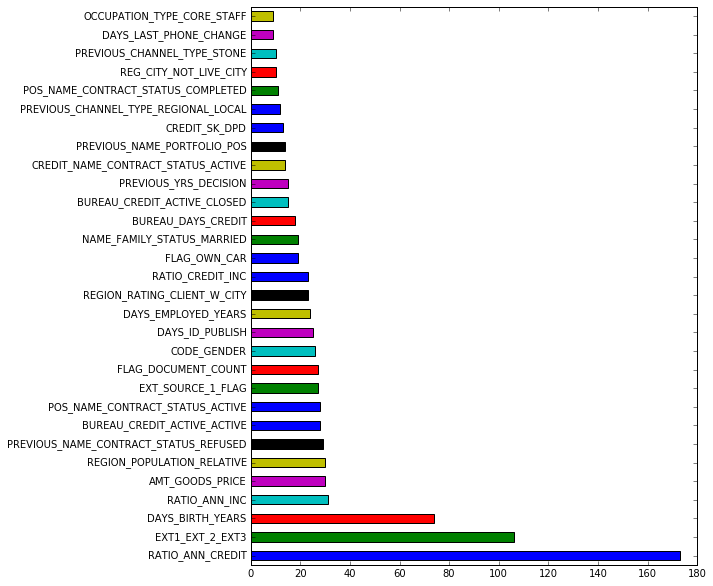

In [64]:
feat_imp = pd.Series(clf.feature_importances_, index=X_train.columns)
feat_imp.nlargest(30).plot(kind='barh', figsize=(8,10))
plt.savefig('LGBM_importance.png', bbox_inches='tight');

In [73]:
#

In [74]:
import shap

C:\Users\Barry\Anaconda3\lib\site-packages\sklearn\cross_validation.py:41: DeprecationWarning: This module was deprecated in version 0.18 in favor of the model_selection module into which all the refactored classes and functions are moved. Also note that the interface of the new CV iterators are different from that of this module. This module will be removed in 0.20.
  "This module will be removed in 0.20.", DeprecationWarning)


In [75]:
shap.initjs()

In [76]:
shap_values = shap.TreeExplainer(clf.booster_).shap_values(X_train)

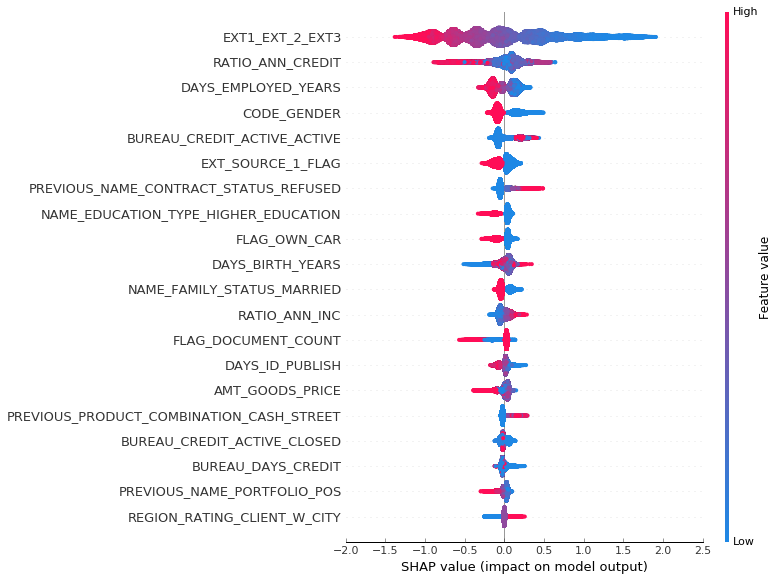

In [77]:
shap.summary_plot(shap_values, X_train);
#plt.savefig('shap_summary_featimp.png', bbox_inches='tight');

In [30]:
#

In [98]:
explainer = shap.TreeExplainer(clf)
shap_values = explainer.shap_values(X_train)

In [99]:
# Choose a record to see how it is influenced by factors.  Change # in below to select specific record.

In [100]:
shap.force_plot(explainer.expected_value, shap_values[0,:], X_train.iloc[0,:])

In [101]:
shap.force_plot(explainer.expected_value, shap_values[123,:], X_train.iloc[123,:])

In [107]:
#

In [108]:
shap.force_plot(explainer.expected_value, shap_values[0:1000,:], X_train.iloc[0:1000,:])

In [41]:
#

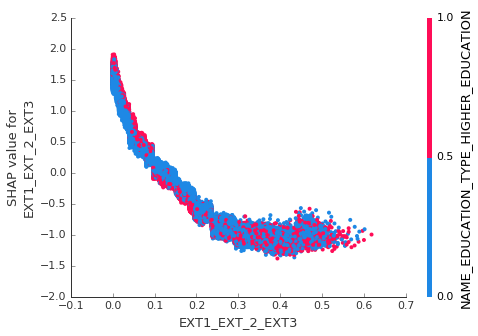

In [110]:
shap.dependence_plot('EXT1_EXT_2_EXT3', shap_values, X_train)

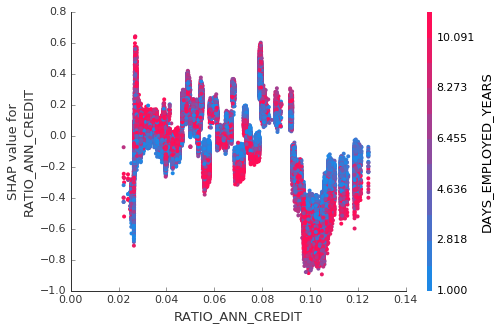

In [112]:
shap.dependence_plot('RATIO_ANN_CREDIT', shap_values, X_train)

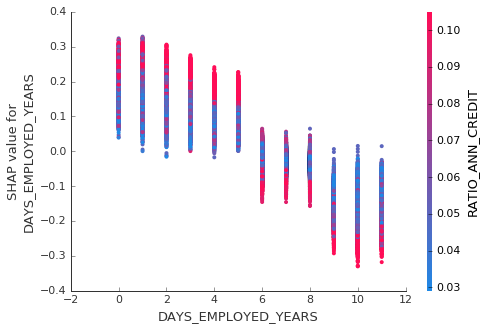

In [113]:
shap.dependence_plot('DAYS_EMPLOYED_YEARS', shap_values, X_train)

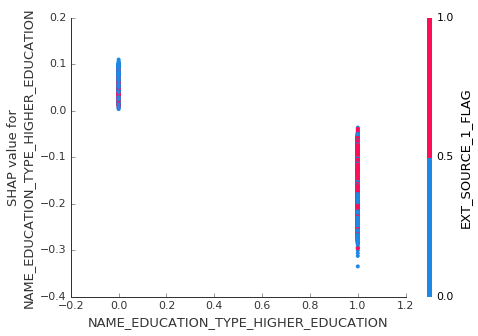

In [114]:
shap.dependence_plot('NAME_EDUCATION_TYPE_HIGHER_EDUCATION', shap_values, X_train)

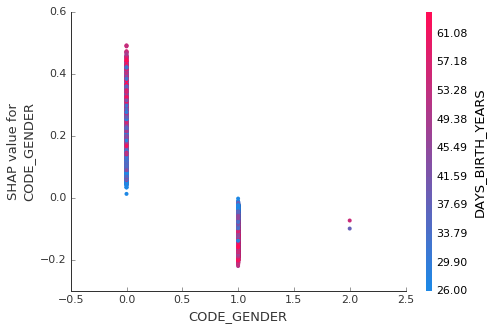

In [115]:
shap.dependence_plot('CODE_GENDER', shap_values, X_train)

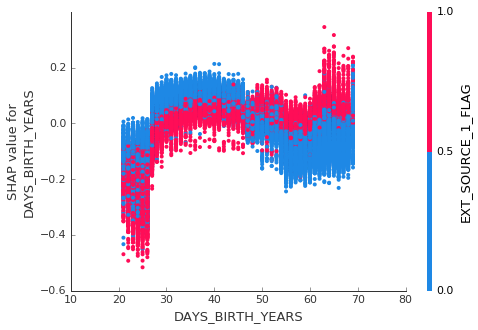

In [116]:
shap.dependence_plot('DAYS_BIRTH_YEARS', shap_values, X_train)

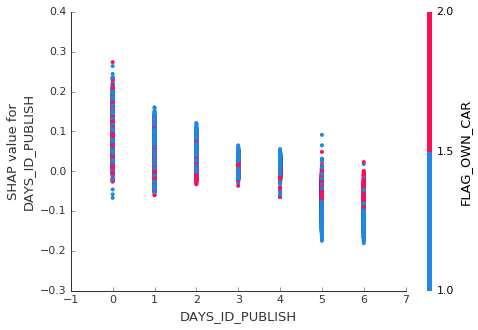

In [117]:
shap.dependence_plot('DAYS_ID_PUBLISH', shap_values, X_train)

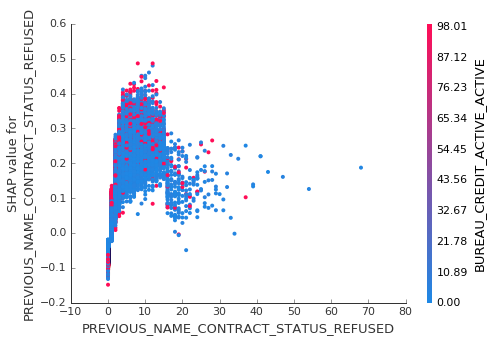

In [118]:
shap.dependence_plot('PREVIOUS_NAME_CONTRACT_STATUS_REFUSED', shap_values, X_train)

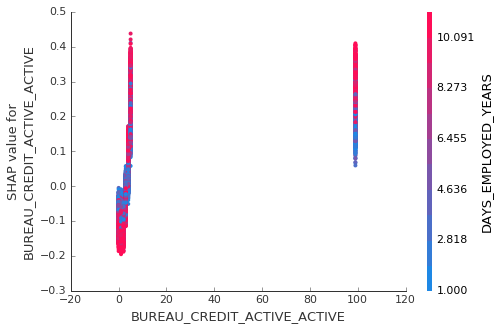

In [120]:
shap.dependence_plot('BUREAU_CREDIT_ACTIVE_ACTIVE', shap_values, X_train)

In [53]:
#

In [121]:
# --- LIME ---

In [122]:
import lime

In [123]:
import lime.lime_tabular

In [124]:
explainer = lime.lime_tabular.LimeTabularExplainer(X_train, feature_names=X_train.columns, 
                                                   class_names=['No Default', 'Yes Default'], discretize_continuous=False)

In [125]:
i = np.random.randint(0, X_test.shape[0])
exp = explainer.explain_instance(X_test.loc[i], clf.predict_proba, num_features=10)
exp.show_in_notebook(show_table=True)
print('Record # ',i)

Record #  6767


In [126]:
i=0
exp = explainer.explain_instance(X_test.loc[i], clf.predict_proba, num_features=10)
exp.show_in_notebook(show_table=True)

In [127]:
i=123
exp = explainer.explain_instance(X_test.loc[i], clf.predict_proba, num_features=10)
exp.show_in_notebook(show_table=True)

In [128]:
i=98
exp = explainer.explain_instance(X_test.loc[i], clf.predict_proba, num_features=10)
exp.show_in_notebook(show_table=True)

In [129]:
i=597
exp = explainer.explain_instance(X_test.loc[i], clf.predict_proba, num_features=10)
exp.show_in_notebook(show_table=True)

In [130]:
i=3
exp = explainer.explain_instance(X_test.loc[i], clf.predict_proba, num_features=10)
exp.show_in_notebook(show_table=True)

In [187]:
i=53453
exp = explainer.explain_instance(X_test.loc[i], clf.predict_proba, num_features=10)
exp.show_in_notebook(show_table=True)

In [131]:
#

In [65]:
y_prob = clf.predict_proba(X_test)

In [66]:
y_prob

array([[0.53518463, 0.46481537],
       [0.79964033, 0.20035967],
       [0.66238726, 0.33761274],
       ...,
       [0.48440973, 0.51559027],
       [0.47415992, 0.52584008],
       [0.66902899, 0.33097101]])

In [82]:
y_prob[:,1]

array([0.46481537, 0.20035967, 0.33761274, ..., 0.51559027, 0.52584008,
       0.33097101])

In [67]:
y_prob.argmin()

95071

In [68]:
y_prob[ :,0 ].argmin()

17136

In [69]:
y_prob[53453]

array([0.06851102, 0.93148898])

In [71]:
y_pred = clf.predict(X_test)

C:\Users\Barry\Anaconda3\lib\site-packages\sklearn\preprocessing\label.py:151: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  if diff:


In [127]:
proby

array([0.45184936, 0.18201487, 0.32016291, ..., 0.51441836, 0.46932196,
       0.29363834])

In [73]:
y_pred

array([0, 0, 0, ..., 1, 1, 0], dtype=int64)

In [74]:
from sklearn.metrics import accuracy_score, roc_auc_score

In [75]:
from sklearn import metrics

In [76]:
thresh=np.arange(0.30,0.60,.01)

In [83]:
print('Threshold','AUC_ROC','ACCURACY')
threshdata=pd.DataFrame([])
for x in thresh:
    ypred = np.where(y_prob[:,1] > x, 1, 0)
    auc_roc=metrics.roc_auc_score(y_test,ypred)
    accuracy=metrics.accuracy_score(ypred,y_test)
    print(x,auc_roc,accuracy)

Threshold AUC_ROC ACCURACY
0.3 0.6445962222713775 0.4203928327534064
0.31 0.6497478144010385 0.4369613996292803
0.32 0.6543741752606779 0.45273324444733504
0.33 0.6583922462398548 0.46772462684140353
0.34 0.6621949560585151 0.48333387532112776
0.35000000000000003 0.6669889932809963 0.49856915222269194
0.36000000000000004 0.6717315289262867 0.5132028226724334
0.37000000000000005 0.6748252033476598 0.5280153490943384
0.38000000000000006 0.6788221198887366 0.5431368085590712
0.39000000000000007 0.6805792229840176 0.5568436798803291
0.4000000000000001 0.6843039008659125 0.5718025430067315
0.4100000000000001 0.6880601357810582 0.5861435400474782
0.4200000000000001 0.6898949215653056 0.5996552957627395
0.4300000000000001 0.6912275389073899 0.612581704660011
0.4400000000000001 0.6939409448415239 0.6266950668270951
0.4500000000000001 0.6952366292288826 0.6400604858378589
0.46000000000000013 0.6973486803459878 0.6530681929042957
0.47000000000000014 0.6981702857927168 0.6653929953497447
0.480000

In [284]:
for i in range(0,len(y_pred)):
    if y_pred[i,1]>=.49:       # setting threshold to max auc_roc from above
       y_pred[i,1]=1
    else:  
       y_pred[i,1]=0

In [143]:
y_pred=[]

In [147]:
y_pred = np.where(proby > 0.49, 1, 0)

In [148]:
y_pred

array([0, 0, 0, ..., 1, 0, 0])

In [286]:
#y_pred_bin = y_pred[:,1]

In [84]:
from sklearn.metrics import confusion_matrix

In [85]:
cm = confusion_matrix(y_test, y_pred)

In [101]:
accuracy=accuracy_score(y_pred,y_test)

In [87]:
cm

array([[39642, 16897],
       [ 1493,  3470]], dtype=int64)

In [102]:
accuracy

0.7009853338102826

In [89]:
from sklearn.metrics import precision_score, recall_score, f1_score, auc

In [90]:
precision_score(y_pred, y_test)

0.6991738867620391

In [99]:
roc_auc_score(y_test, y_prob[:,1])

0.7666400227421614

In [92]:
recall_score(y_test, y_pred)

0.6991738867620391

In [93]:
f1_score(y_test, y_pred)

0.27398341887090405

In [94]:
fpr, tpr, thresholds = metrics.roc_curve(y_test, y_pred, pos_label=1)
auc(fpr, tpr)

0.7001591148025161

In [95]:
from sklearn.metrics import auc

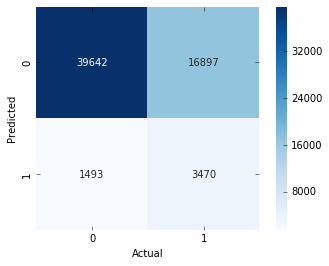

In [96]:
sns.heatmap(cm, annot=True, fmt='g', cmap = plt.get_cmap('Blues'), square=True)
#plt.savefig('CM_LGBM.png', bbox_inches='tight')
plt.ylabel('Predicted')
plt.xlabel('Actual');

In [97]:
from sklearn import metrics

y_true = y_test
y_probas = proby
fpr, tpr, thresholds = metrics.roc_curve(y_true, y_probas, pos_label=1)

# Print ROC curve
plt.plot(fpr,tpr)
plt.savefig('ROC_LGBM.png', bbox_inches='tight')
plt.show() 

# Print AUC
auc = np.trapz(tpr,fpr)
print('AUC:', auc)

NameError: name 'proby' is not defined

In [154]:
#

In [161]:
from sklearn.metrics import roc_curve, auc
false_positive_rate, true_positive_rate, thresholds = roc_curve(y_test, y_probas)
roc_auc = auc(false_positive_rate, true_positive_rate)

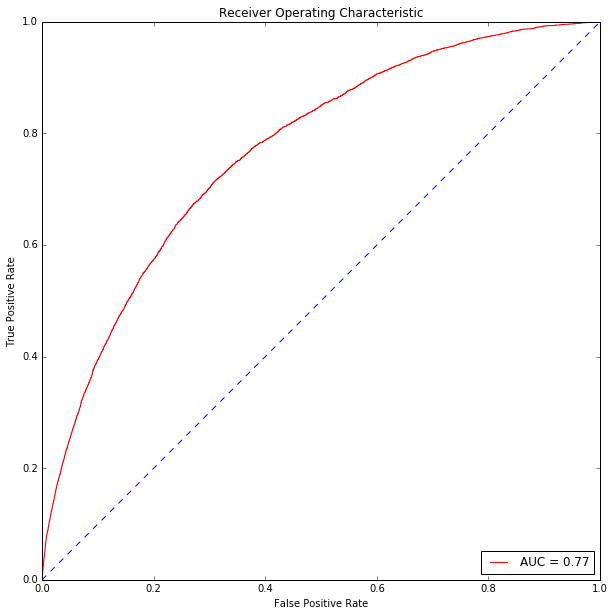

In [163]:
plt.figure(figsize=(10,10))
plt.title('Receiver Operating Characteristic')
plt.plot(false_positive_rate,true_positive_rate, color='red',label = 'AUC = %0.2f' % roc_auc)
plt.legend(loc = 'lower right')
plt.plot([0, 1], [0, 1],linestyle='--')
plt.axis('tight')
plt.ylabel('True Positive Rate')
plt.xlabel('False Positive Rate')
plt.savefig('ROC_LGBM.png', bbox_inches='tight');